In [ ]:
# @title
### EP2 MAC0417 / MAC5768
##################################################################
# AO PREENCHER ESSE CABEÇALHO COM O MEU NOME E O MEU NÚMERO USP,#
# DECLARO QUE SOU O ÚNICO AUTOR E RESPONSÁVEL PELA RESOLUÇÃO #
# DESTE EP. #
# TODAS AS PARTES FORAM DESENVOLVIDAS E IMPLEMENTADAS POR MIM, #
# SEGUINDO AS INSTRUÇÕES E QUE PORTANTO, NÃO CONSTITUEM #
# DESONESTIDADE ACADÊMICA OU PLÁGIO. #
# #
# DECLARO TAMBÉM, QUE SOU RESPONSÁVEL POR TODAS AS CÓPIAS #
# DESSE PROGRAMA, E QUE EU NÃO DISTRIBUI OU FACILITEI A #
# SUA DISTRIBUIÇÃO. ESTOU CIENTE QUE OS CASOS DE PLÁGIO E #
# DESONESTIDADE ACADÊMICA SERÃO TRATADOS SEGUNDO OS CRITÉRIOS #
# DEFINIDOS NO CÓDIGO DE ÉTICA DA USP. #
# #
# ENTENDO QUE JUPYTER NOTEBOOKS SEM ASSINATURA NÃO SERÃO #
# CORRIGIDOS E, AINDA ASSIM, PODERÃO SER PUNIDOS POR #
# DESONESTIDADE ACADÊMICA. #
# #
# #
# Nome : # Mikhail Futorny
# NUSP : # 5258765
# Turma: # MAC-0417
# Prof.: # Ronaldo Fumio Hashimoto #  
##################################################################

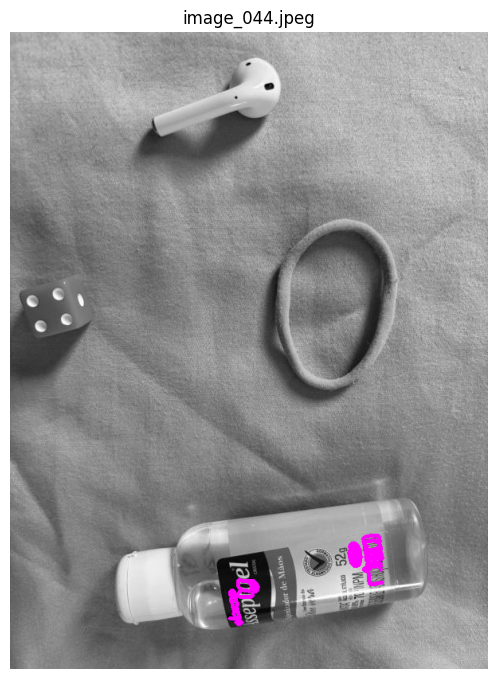

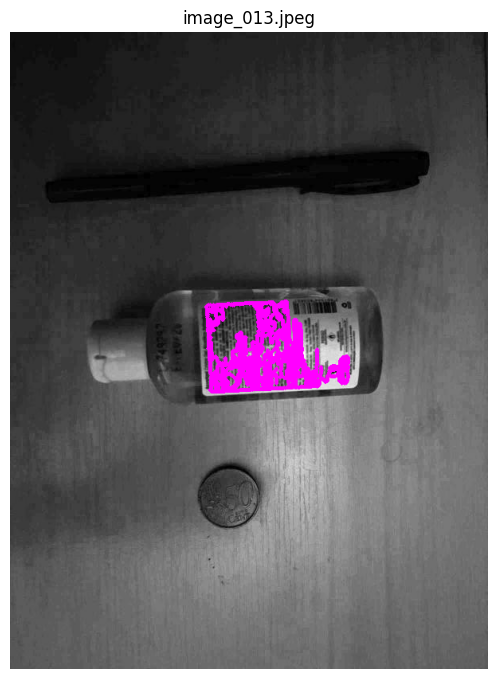

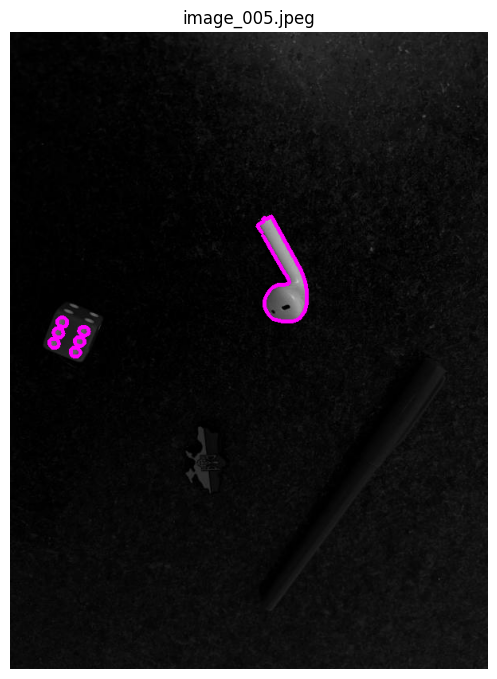

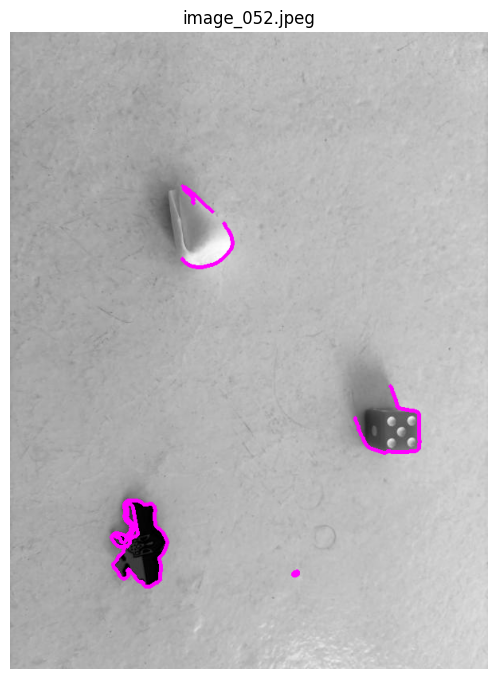

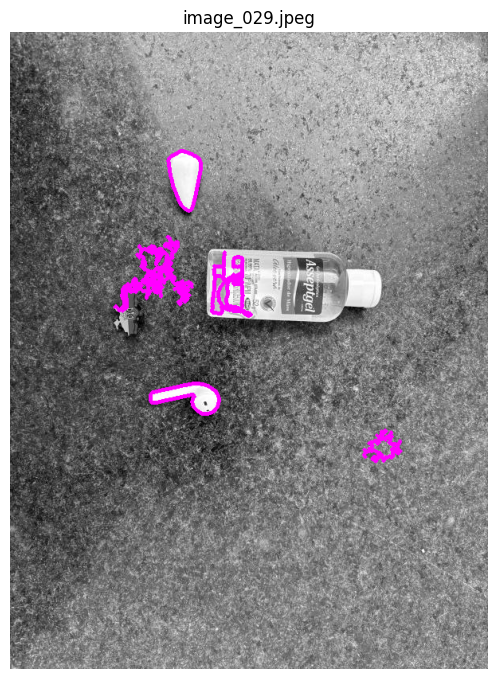

...

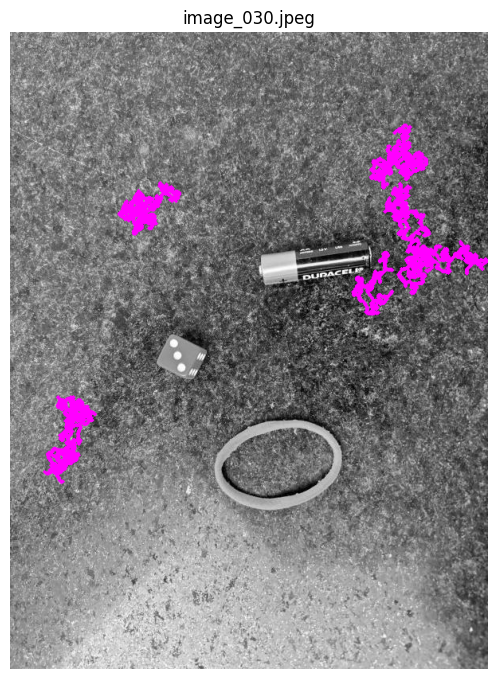

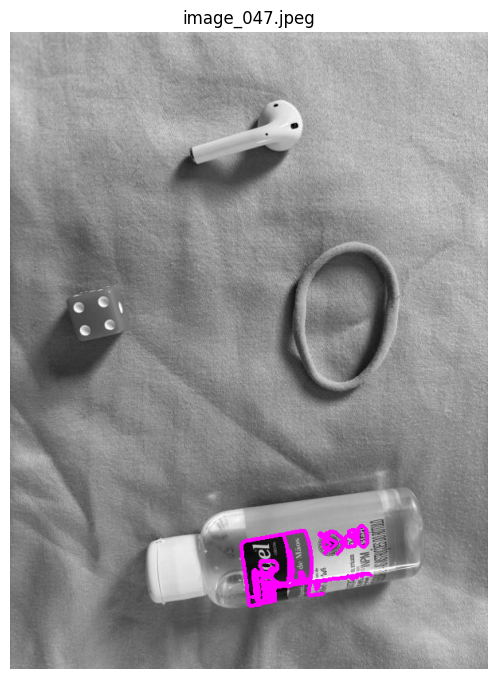

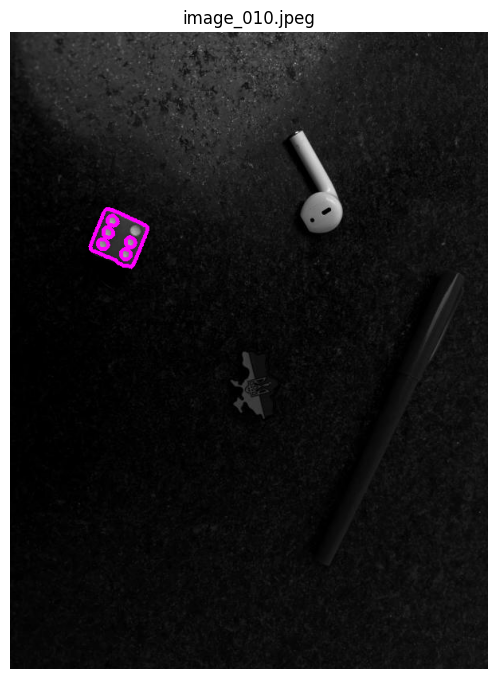

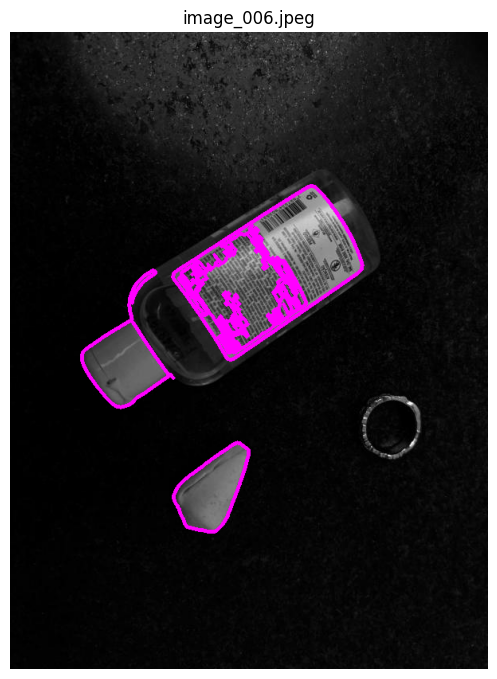

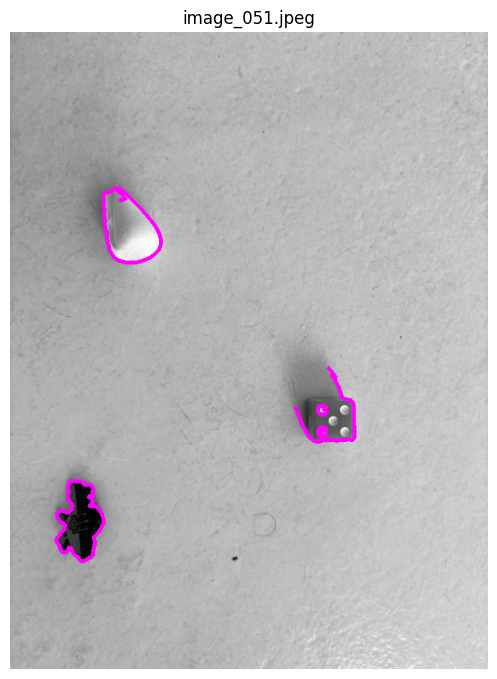

In [100]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

# Blurring functions
def gaussian_blur(img, kernel_size=(5, 5), sigma=0): #melhor edge detection (mais visivel a olho nu)
    blurred_img = cv2.GaussianBlur(img, kernel_size, sigma)
    return blurred_img

def median_blur(img, kernel_size=5):
    blurred_img = cv2.medianBlur(img, kernel_size)
    return blurred_img

def bilateral_filter(img, d=9, sigma_color=75, sigma_space=75):
    filtered_img = cv2.bilateralFilter(img, d, sigma_color, sigma_space)
    return filtered_img

def gradient_threshold(img, threshold): #Muito ruido de fundo
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=5)
    gradient_magnitude = np.sqrt(sobelx**2 + sobely**2)
    _, binary_gradient = cv2.threshold(gradient_magnitude, threshold, 255, cv2.THRESH_BINARY)
    return binary_gradient

def canny_edge(img, low_threshold, high_threshold): #funcinou muito bem (melhor filtro)
    edges = cv2.Canny(img, low_threshold, high_threshold)
    return edges

def marr_hildreth(img, sigma, threshold):
    blurred = cv2.GaussianBlur(img, (0, 0), sigma)
    laplacian = cv2.Laplacian(blurred, cv2.CV_64F)
    _, binary_laplacian = cv2.threshold(np.abs(laplacian), threshold, 255, cv2.THRESH_BINARY)
    binary_laplacian = binary_laplacian.astype(np.uint8)
    
    return binary_laplacian

folder_path = './content/augmentedDataSet/Normal/' #mudar para pasta que deseja imprimir


for filename in os.listdir(folder_path):
    if filename.endswith('.jpeg'):
        image_path = os.path.join(folder_path, filename)
        img = cv2.imread(image_path)

        # Converte para rgb
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Gaussiano teve melhor performance nos testes
        gaussian_blur_img = gaussian_blur(img)
        gaussian_blur_gray = cv2.cvtColor(gaussian_blur_img, cv2.COLOR_BGR2GRAY)

        # Canny teve melhor edge detection nos testes
        canny_gaussian = canny_edge(gaussian_blur_gray, 50, 150)

        
        contours, hierarchy = cv2.findContours(canny_gaussian, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

        areas = [cv2.contourArea(c) for c in contours]
        areas.sort()

        n = len(areas)
        maiores_areas = []
        for c in contours:
            if cv2.contourArea(c) >= areas[n-7]:
                maiores_areas.append(c)

        # Desenha na imagem original
        img_contours = img.copy()
        cv2.drawContours(img_contours, maiores_areas, -1, (255, 0, 255), 3)

        img_contours_rgb = cv2.cvtColor(img_contours, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(10, 7))

        plt.subplot(1, 2, 2) # imprime para seleção manual
        plt.imshow(img_contours_rgb)
        plt.title(filename)
        plt.axis('off')

        plt.tight_layout()
        plt.show()

In [102]:
# Selecionei manualmente 069, 051, 052, 068, 009, 065, 053.


#Execute celula para gerar pasta com os contornos das imagens selecionadas


output_path = './content/selecionadas/'  # Pasta de saída para salvar os contornos

if not os.path.exists(output_path):
    os.makedirs(output_path)

# Lista de melhores imagens
suffixes = ['069.jpeg', '051.jpeg', '052.jpeg', '068.jpeg', '009.jpeg', '065.jpeg', '053.jpeg']

for filename in os.listdir(folder_path):
    if filename.endswith('.jpeg') and any(suffix in filename for suffix in suffixes):
        image_path = os.path.join(folder_path, filename)
        img = cv2.imread(image_path)

        # Gaussiano teve melhor performance nos testes
        gaussian_blur_img = gaussian_blur(img)
        gaussian_blur_gray = cv2.cvtColor(gaussian_blur_img, cv2.COLOR_BGR2GRAY)

        # Canny teve melhor edge detection nos testes
        canny_gaussian = canny_edge(gaussian_blur_gray, 50, 150)

        contours, hierarchy = cv2.findContours(canny_gaussian, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

        areas = [cv2.contourArea(c) for c in contours]
        areas.sort()

        n = len(areas)
        maiores_areas = []
        for c in contours:
            if cv2.contourArea(c) >= areas[n-7]:
                maiores_areas.append(c)

        # Criar imagem apenas com os contornos
        contour_img = np.zeros_like(img)
        cv2.drawContours(contour_img, maiores_areas, -1, (255, 255, 255), 1)
        output_filename = os.path.splitext(filename)[0] + '_contour.jpeg'  # Nome da imagem de saída
        output_img_path = os.path.join(output_path, output_filename)
        cv2.imwrite(output_img_path, contour_img)
